In [ ]:
'''
from google.colab import drive
drive.mount('/content/drive')
'''

Mounted at /content/drive


In [ ]:
!pip install kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d paultimothymooney/chest-xray-pneumonia
!unzip chest-xray-pneumonia.zip


Streaming output truncated to the last 5000 lines.
  inflating: chest_xray/train/NORMAL/IM-0435-0001-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0435-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0437-0001-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0437-0001-0002.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0437-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0438-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0439-0001-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0439-0001-0002.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0439-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0440-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0441-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0442-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0444-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0445-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0446-0001.jpeg  
  inflating: chest_xray/train/NORMAL/IM-0447-0001.jpeg  
  inflating:

Preprocess data by making slight adjustments that way the model is better at recognizing and correctly categorizing x-ray images

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# modifies the training data with slight changes to allow for the model to work
# better and be able to correctly classify more images
train_datagen = ImageDataGenerator(
  rescale=1./255,
  rotation_range=15,
  width_shift_range=0.1,
  height_shift_range=0.1,
  shear_range=0.1,
  zoom_range = 0.1,
  horizontal_flip = True,
  fill_mode = 'nearest'
)


# rescales validation and test data as those will be used to test the model
# and do not need to be modified
test_val_datagen = ImageDataGenerator(rescale=1./255)
'''
# Load data from directories
train_generator = train_datagen.flow_from_directory(
   'chest_xray/train',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary'
)

validation_generator = test_val_datagen.flow_from_directory(
    'chest_xray/val',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary'
)
'''
test_generator = test_val_datagen.flow_from_directory(
    'chest_xray/test',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    shuffle=False
)


train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2  # 20% of train used for validation
)

train_generator = train_datagen.flow_from_directory(
    'chest_xray/train',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'chest_xray/train',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='validation'
)



Found 624 images belonging to 2 classes.
Found 4173 images belonging to 2 classes.
Found 1043 images belonging to 2 classes.


Building the CNN Model using a pretrained model

In [ ]:
from re import VERBOSE
#import VGG16
from tensorflow.keras.applications import VGG16
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


# load the VGG16 base model and then freeze it
baseModel = VGG16(
    weights = "imagenet", # load weights pre-trained on ImageNet instead of training from scratch
    include_top = False, # don't include original classifier
    input_shape = (224, 224, 3) #shape of the input image (prev. augmented) (pixel, pixel, # of color channels)
)

# Freezes the base model so that it does not get
# updated during first round of training
baseModel.trainable = False

# Building and compiling the model
from tensorflow.keras import layers, models

model = models.Sequential([
    baseModel, # VGG16 base model
    layers.GlobalAveragePooling2D(), # Reduce to 1D
    layers.Dense(256, activation='relu'), # 256 neurons that use ReLu activiation function
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid') # 1 ouput later that uses sigmoid function
])

model.compile(
    optimizer = 'adam',
    loss = 'binary_crossentropy',
    metrics = ['accuracy']
)

early_stopping = EarlyStopping(
    monitor = 'val_loss',
    patience = 3,
    restore_best_weights=True
    )

#Model checkpoing (saves best epoch to disk)
checkpoint = ModelCheckpoint(
    'pneumoniaDetectionModel.h5', #filename
    monitor = 'val_loss', #track validation loss
    save_best_only = True, #only save best epoch
    mode = 'min', #minimize validation loss
    verbose = 1 #print progress
)

history = model.fit(
          train_generator,
          epochs=20,
          validation_data=validation_generator,
          callbacks = [early_stopping, checkpoint]
          )

Epoch 1/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 681ms/step - accuracy: 0.7724 - loss: 0.4564
Epoch 1: val_loss improved from inf to 0.24138, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 122s 914ms/step - accuracy: 0.7730 - loss: 0.4556 - val_accuracy: 0.9070 - val_loss: 0.2414
Epoch 2/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.9013 - loss: 0.2432
Epoch 2: val_loss improved from 0.24138 to 0.17817, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 801ms/step - accuracy: 0.9014 - loss: 0.2431 - val_accuracy: 0.9386 - val_loss: 0.1782
Epoch 3/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 634ms/step - accuracy: 0.9307 - loss: 0.1842
Epoch 3: val_loss improved from 0.17817 to 0.16674, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 104s 799ms/step - accuracy: 0.9306 - loss: 0.1842 - val_accuracy: 0.9310 - val_loss: 0.1667
Epoch 4/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - accuracy: 0.9309 - loss: 0.1787
Epoch 4: val_loss improved from 0.16674 to 0.14979, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 109s 833ms/step - accuracy: 0.9309 - loss: 0.1787 - val_accuracy: 0.9453 - val_loss: 0.1498
Epoch 5/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step - accuracy: 0.9415 - loss: 0.1611
Epoch 5: val_loss improved from 0.14979 to 0.14814, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 106s 808ms/step - accuracy: 0.9415 - loss: 0.1611 - val_accuracy: 0.9482 - val_loss: 0.1481
Epoch 6/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 633ms/step - accuracy: 0.9418 - loss: 0.1513
Epoch 6: val_loss improved from 0.14814 to 0.14044, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 799ms/step - accuracy: 0.9418 - loss: 0.1514 - val_accuracy: 0.9463 - val_loss: 0.1404
Epoch 7/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 634ms/step - accuracy: 0.9436 - loss: 0.1461
Epoch 7: val_loss improved from 0.14044 to 0.13910, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 124s 951ms/step - accuracy: 0.9435 - loss: 0.1461 - val_accuracy: 0.9501 - val_loss: 0.1391
Epoch 8/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step - accuracy: 0.9449 - loss: 0.1442
Epoch 8: val_loss did not improve from 0.13910
131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 800ms/step - accuracy: 0.9449 - loss: 0.1442 - val_accuracy: 0.9453 - val_loss: 0.1423
Epoch 9/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.9481 - loss: 0.1488
Epoch 9: val_loss improved from 0.13910 to 0.13317, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 142s 798ms/step - accuracy: 0.9481 - loss: 0.1488 - val_accuracy: 0.9521 - val_loss: 0.1332
Epoch 10/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 0.9583 - loss: 0.1178
Epoch 10: val_loss improved from 0.13317 to 0.12623, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 125s 954ms/step - accuracy: 0.9583 - loss: 0.1179 - val_accuracy: 0.9559 - val_loss: 0.1262
Epoch 11/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.9562 - loss: 0.1206
Epoch 11: val_loss improved from 0.12623 to 0.12124, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 122s 801ms/step - accuracy: 0.9562 - loss: 0.1207 - val_accuracy: 0.9578 - val_loss: 0.1212
Epoch 12/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 0.9562 - loss: 0.1195
Epoch 12: val_loss improved from 0.12124 to 0.11557, saving model to pneumoniaDetectionModel.h5


131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 803ms/step - accuracy: 0.9562 - loss: 0.1195 - val_accuracy: 0.9616 - val_loss: 0.1156
Epoch 13/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.9523 - loss: 0.1310
Epoch 13: val_loss did not improve from 0.11557
131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 800ms/step - accuracy: 0.9523 - loss: 0.1309 - val_accuracy: 0.9530 - val_loss: 0.1233
Epoch 14/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 633ms/step - accuracy: 0.9511 - loss: 0.1299
Epoch 14: val_loss did not improve from 0.11557
131/131 ━━━━━━━━━━━━━━━━━━━━ 124s 948ms/step - accuracy: 0.9511 - loss: 0.1298 - val_accuracy: 0.9310 - val_loss: 0.1737
Epoch 15/20
131/131 ━━━━━━━━━━━━━━━━━━━━ 0s 639ms/step - accuracy: 0.9487 - loss: 0.1213
Epoch 15: val_loss did not improve from 0.11557
131/131 ━━━━━━━━━━━━━━━━━━━━ 105s 801ms/step - accuracy: 0.9487 - loss: 0.1213 - val_accuracy: 0.9032 - val_loss: 0.2354


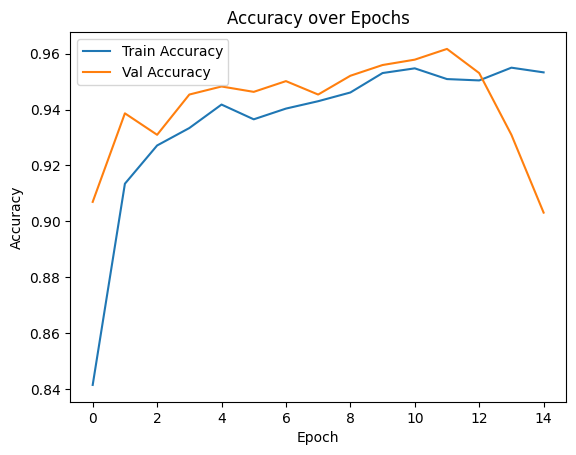

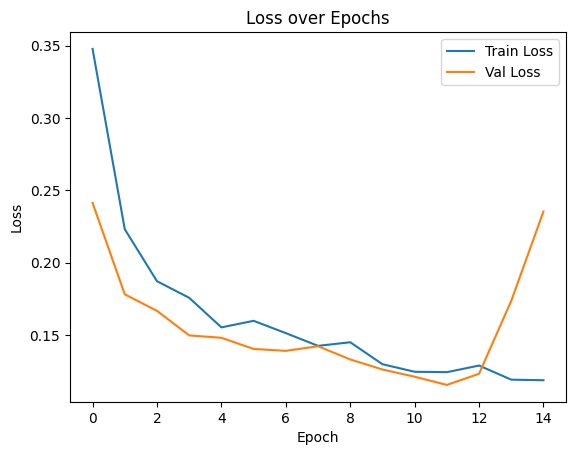

In [ ]:
import matplotlib.pyplot as plt

# Plot accuracy
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy over Epochs')
plt.legend()
plt.show()

# Plot loss
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss over Epochs')
plt.legend()
plt.show()


Evaluating the model on the Test Set

In [ ]:
test_loss, test_acc = model.evaluate(test_generator)
print('Test accuracy:', test_acc)
print('Test loss:', test_loss)

20/20 ━━━━━━━━━━━━━━━━━━━━ 13s 640ms/step - accuracy: 0.8538 - loss: 0.4534
Test accuracy: 0.8990384340286255
Test loss: 0.3108564615249634


Plotting a Confusion Matrix - This is a table that shows the number of correct and incorrect predictions

20/20 ━━━━━━━━━━━━━━━━━━━━ 6s 258ms/step


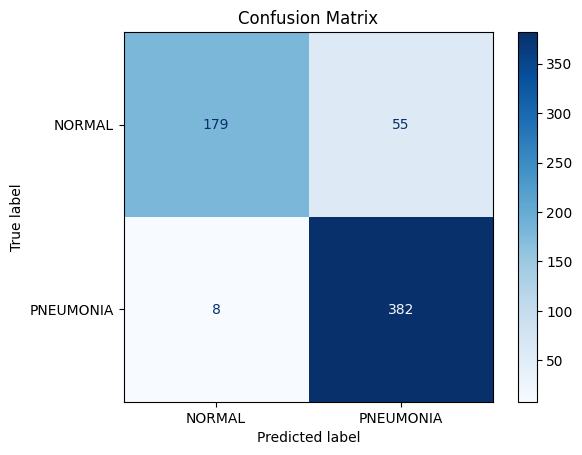

              precision    recall  f1-score   support

      NORMAL       0.96      0.76      0.85       234
   PNEUMONIA       0.87      0.98      0.92       390

    accuracy                           0.90       624
   macro avg       0.92      0.87      0.89       624
weighted avg       0.91      0.90      0.90       624



In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import numpy as np

# Gets predictions
y_pred_probs = model.predict(test_generator)
y_preds = (y_pred_probs > 0.5).astype(int).flatten()

#True labels
y_true = test_generator.classes

#confusion matrix
cm = confusion_matrix(y_true, y_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=test_generator.class_indices)
disp.plot(cmap = 'Blues')
plt.title('Confusion Matrix')
plt.show()

#classification matrix
print(classification_report(y_true, y_preds, target_names = test_generator.class_indices.keys()))

Visualize Predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


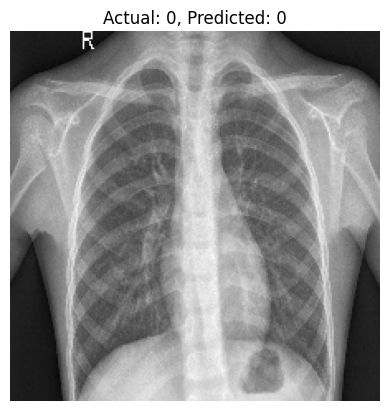

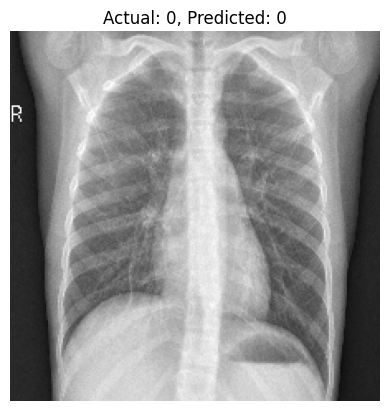

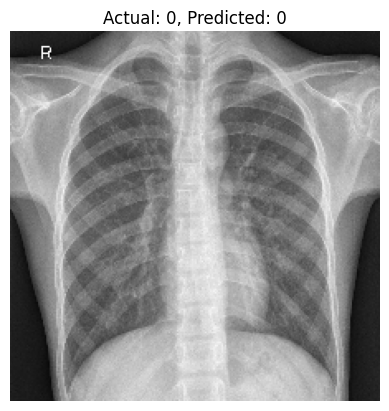

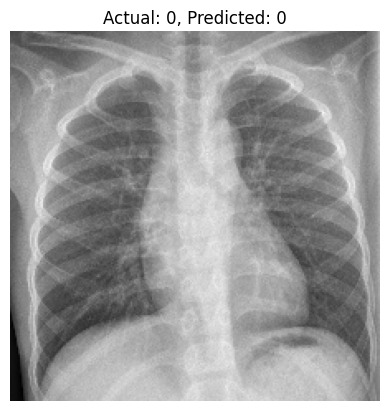

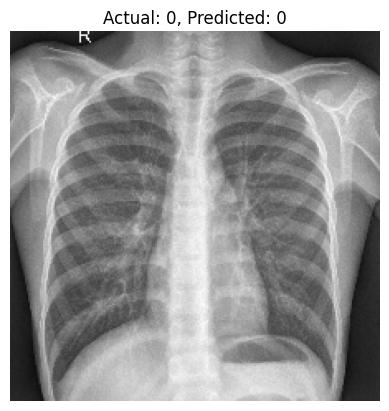

...

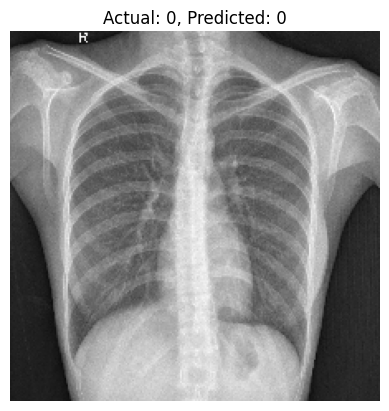

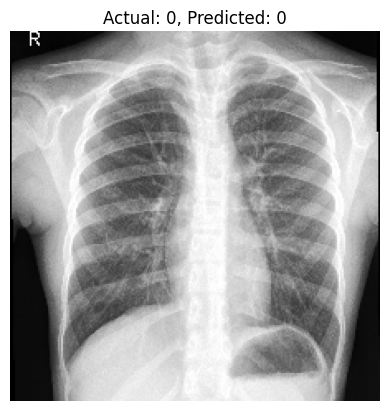

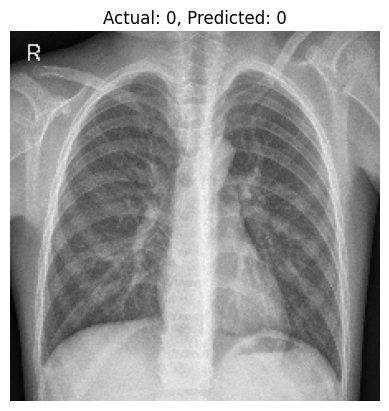

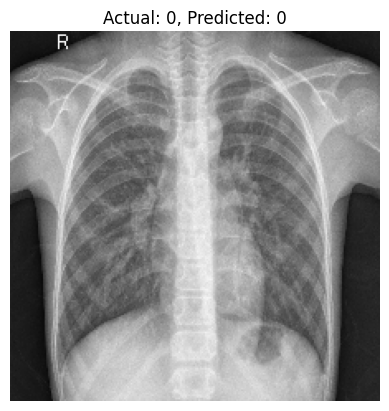

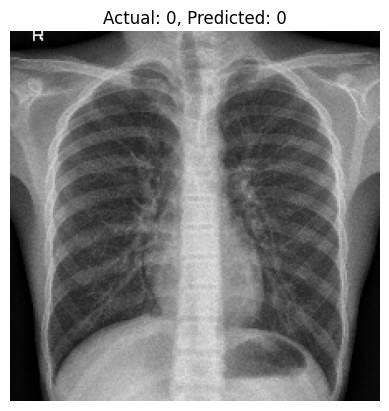

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


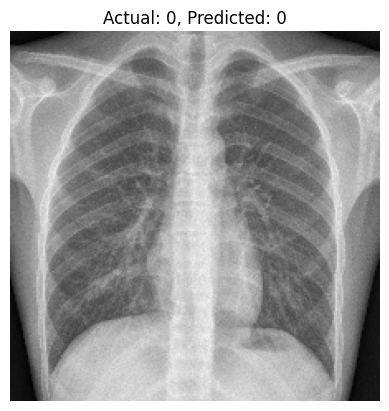

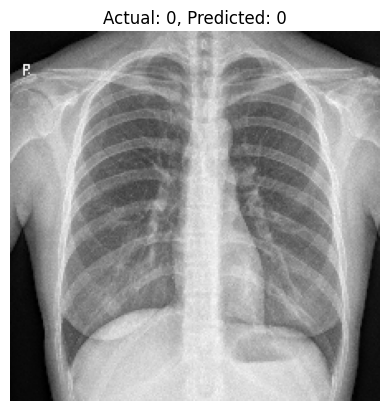

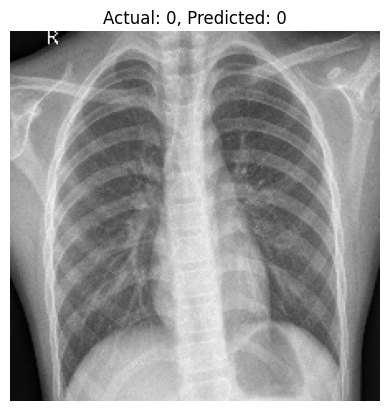

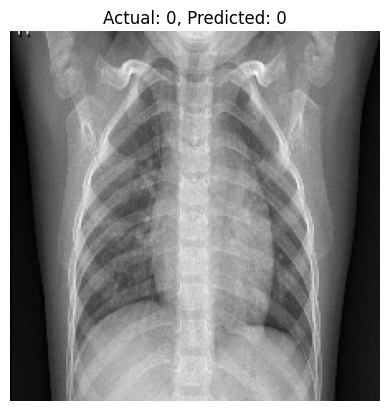

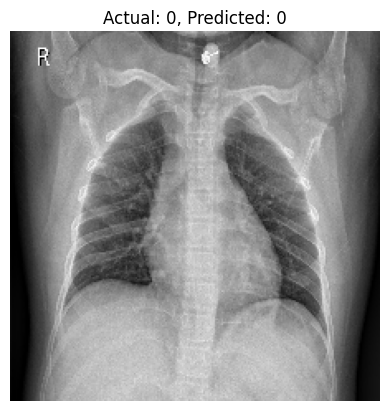

...

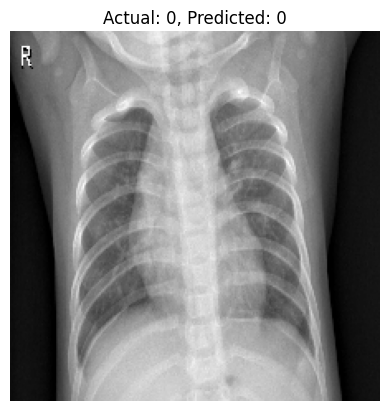

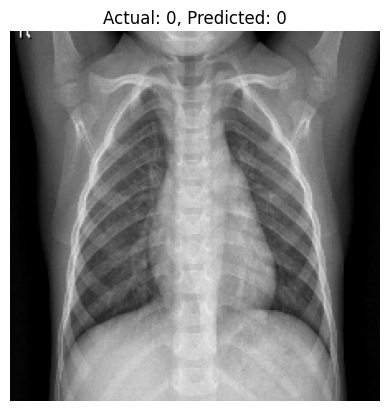

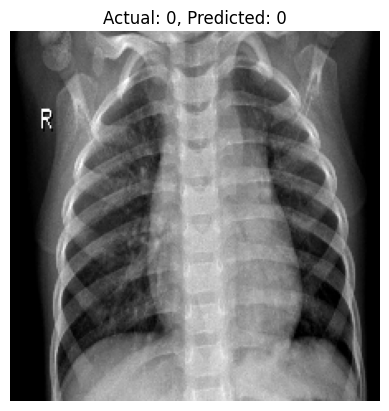

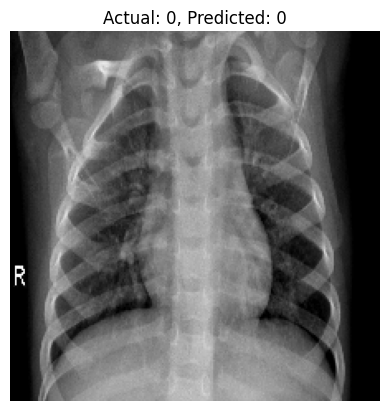

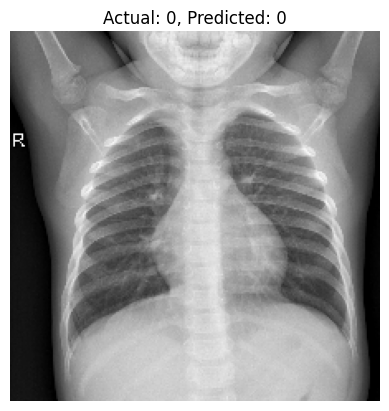

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


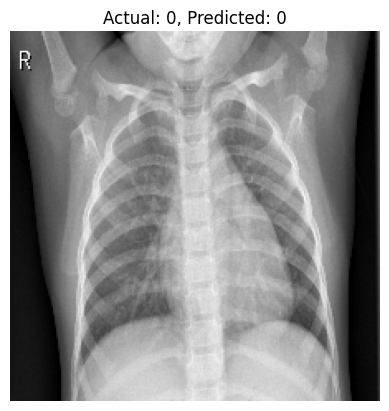

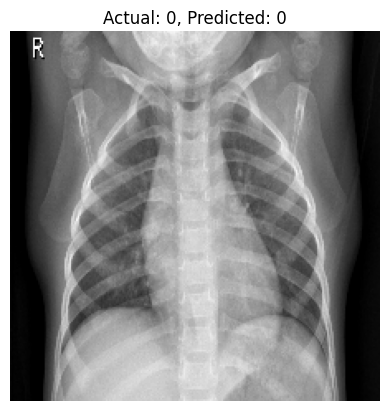

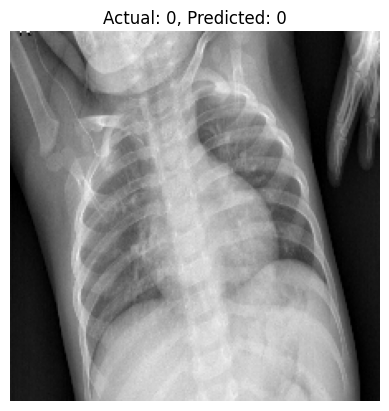

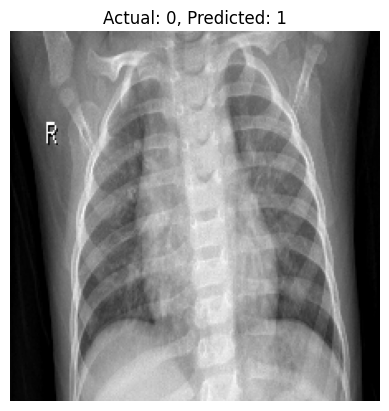

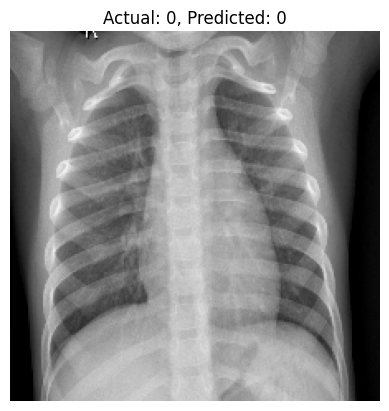

...

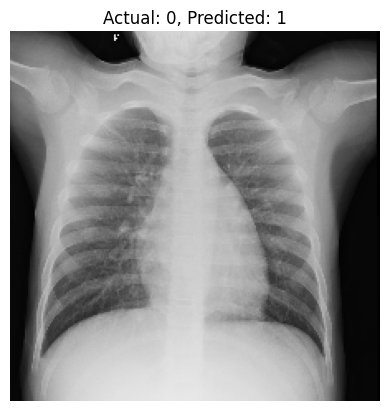

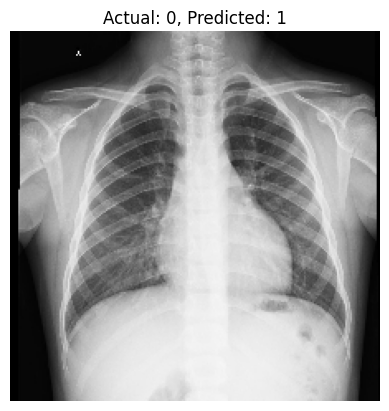

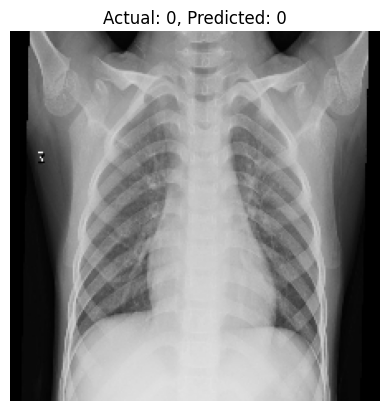

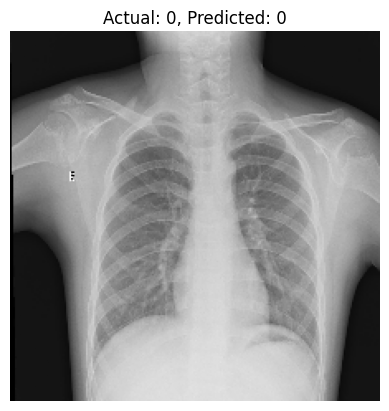

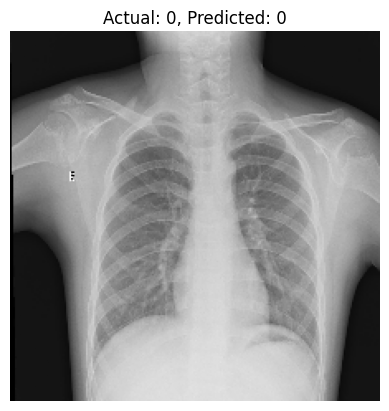

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


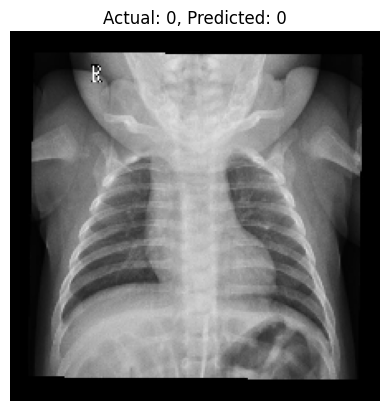

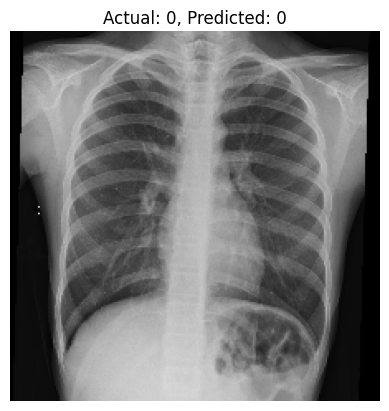

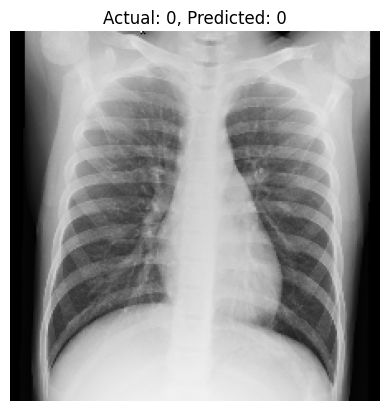

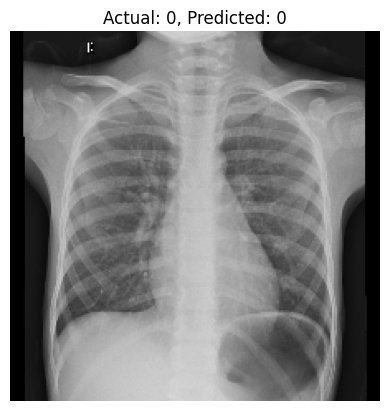

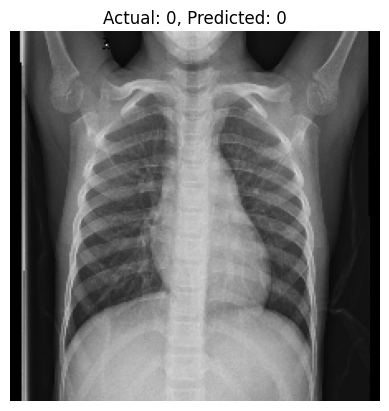

...

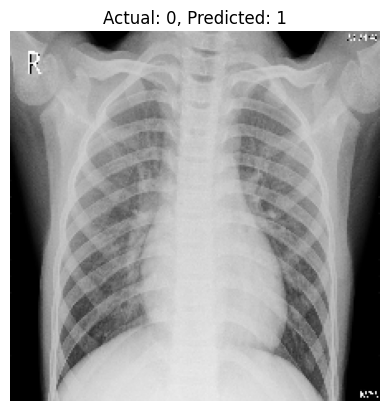

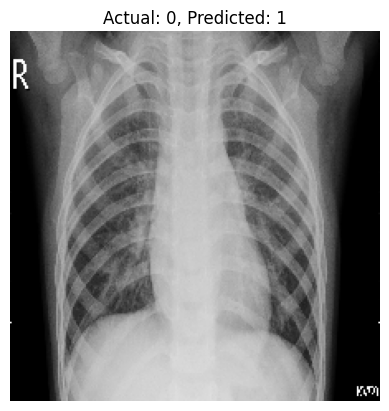

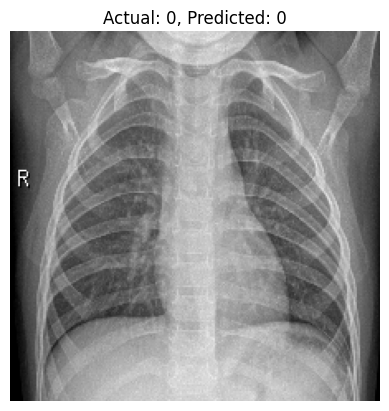

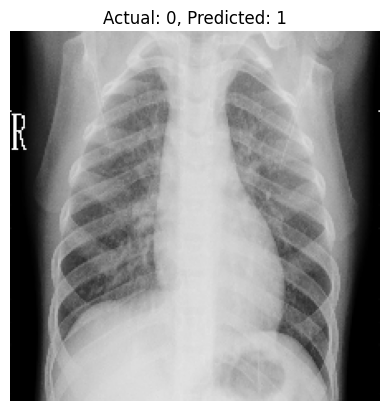

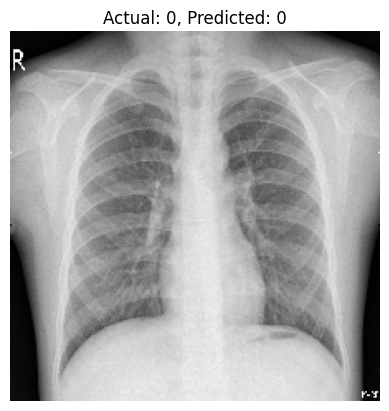

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


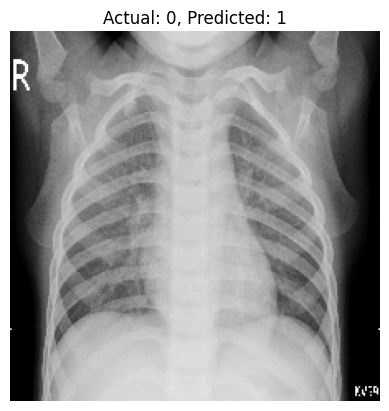

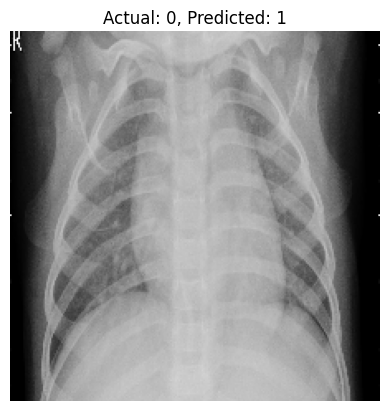

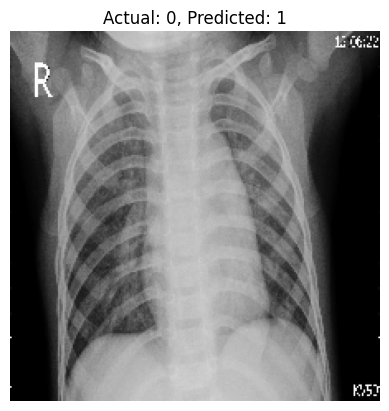

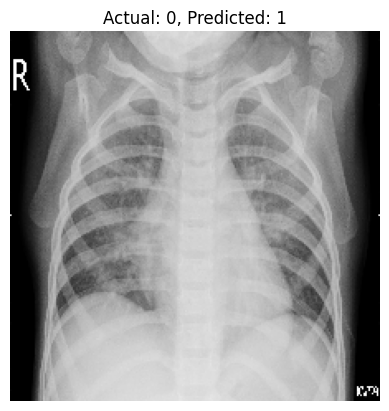

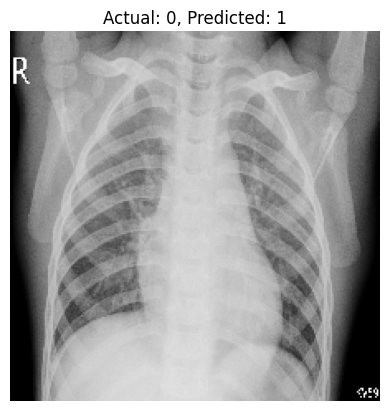

...

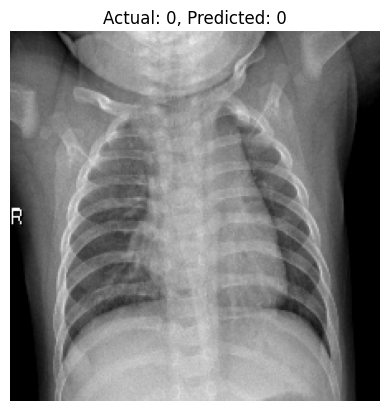

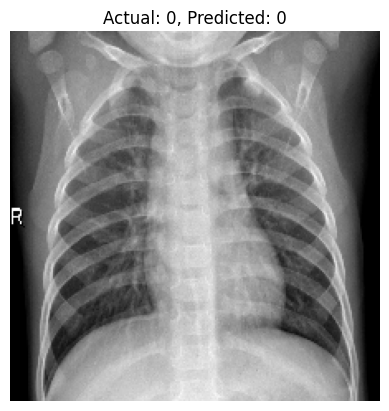

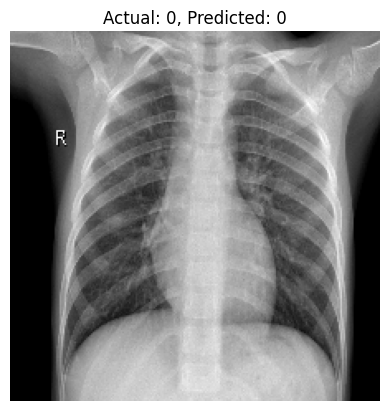

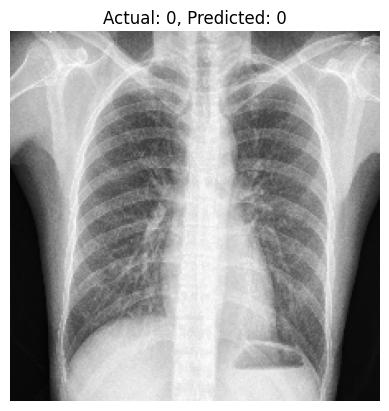

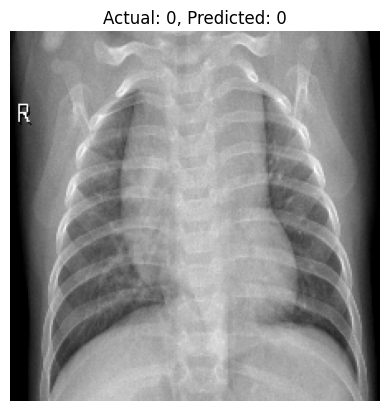

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


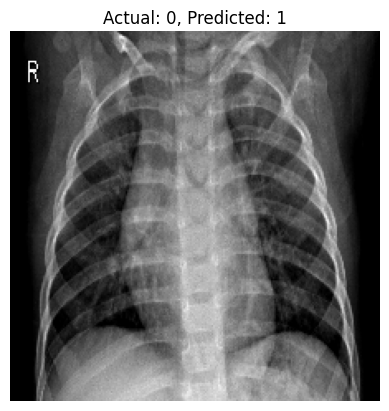

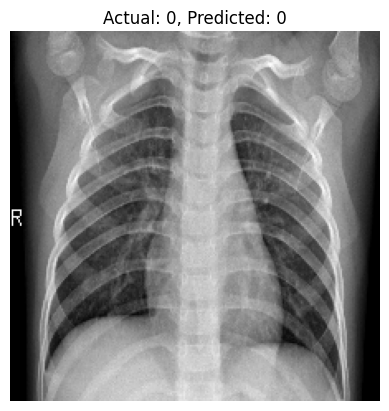

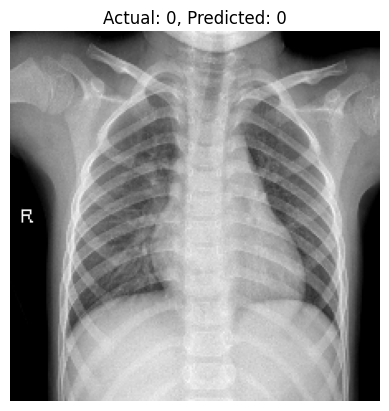

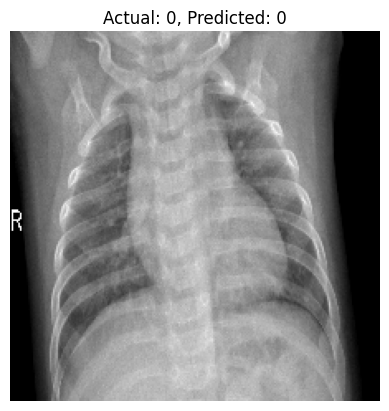

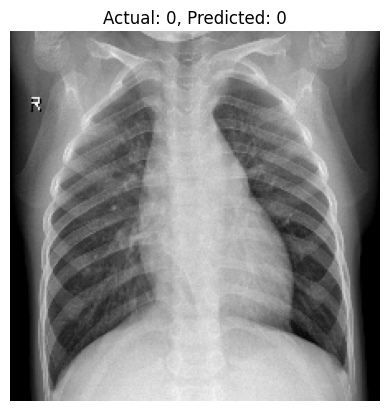

...

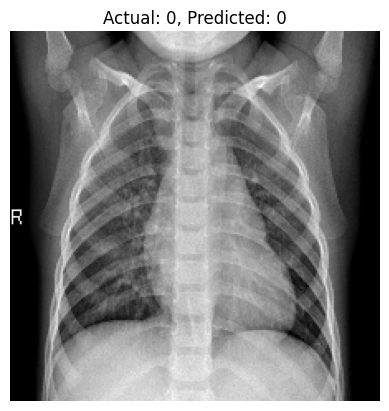

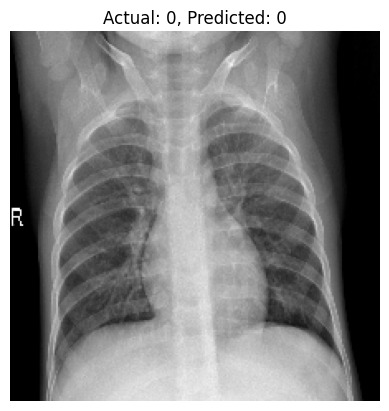

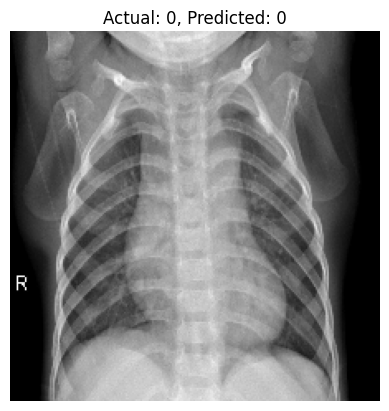

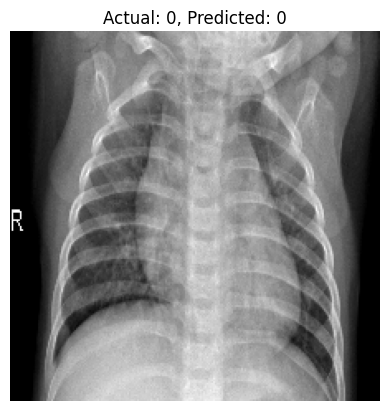

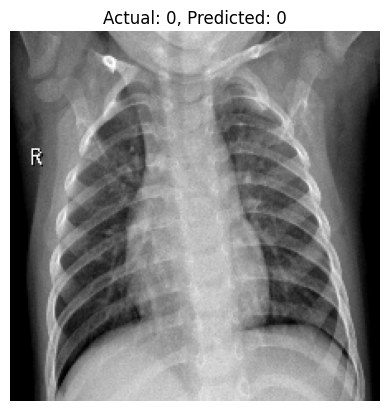

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


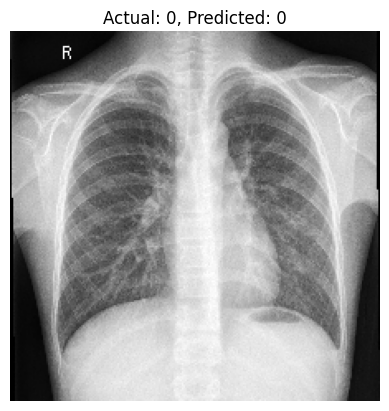

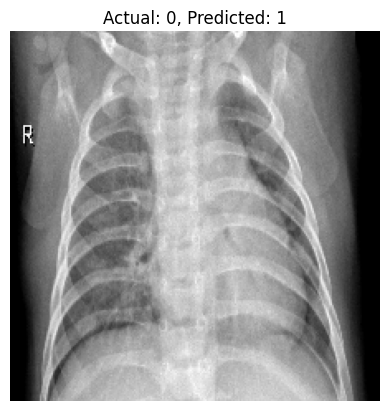

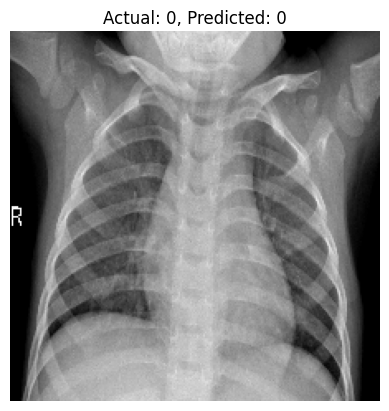

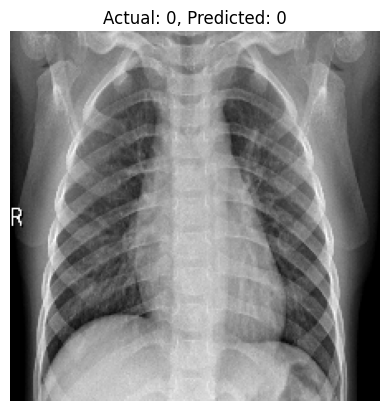

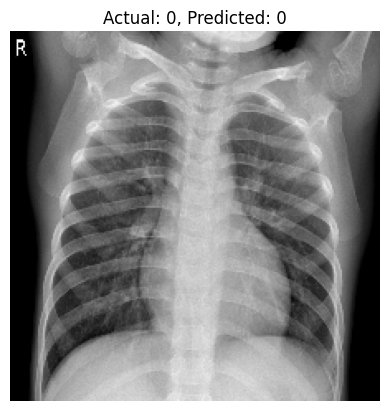

...

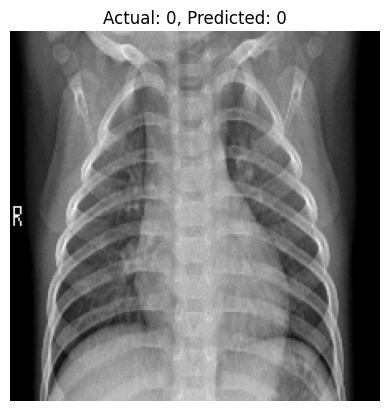

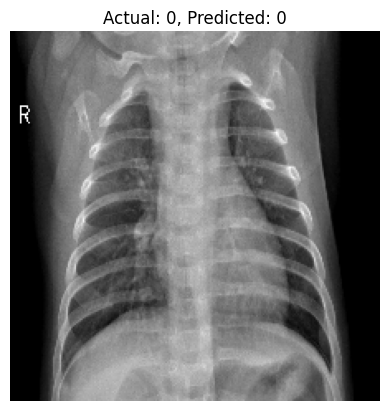

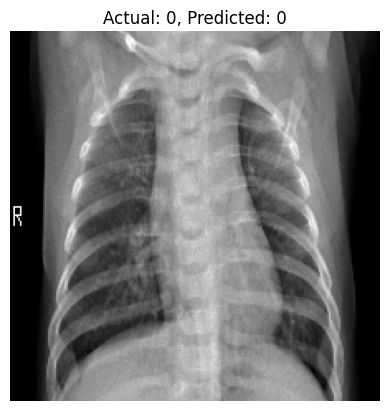

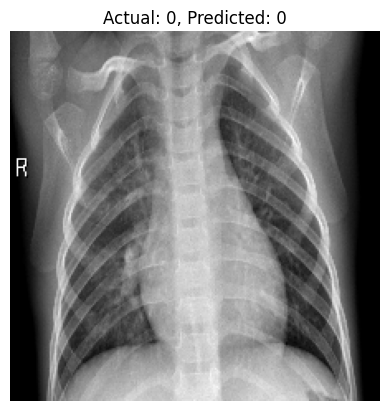

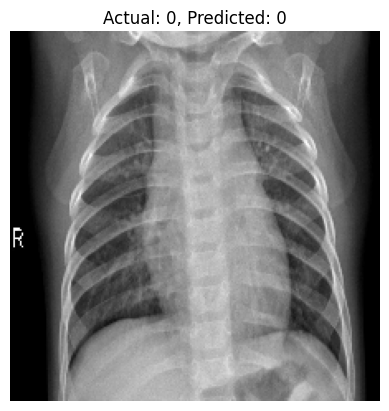

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


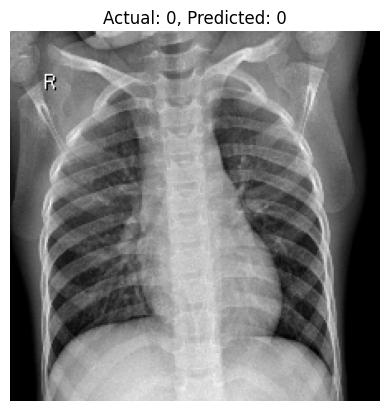

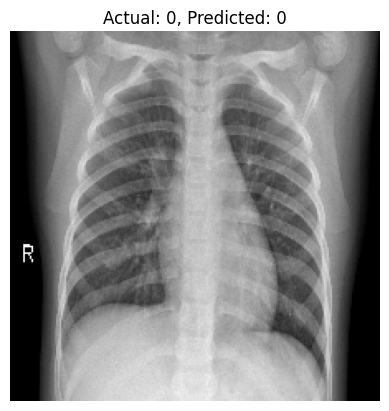

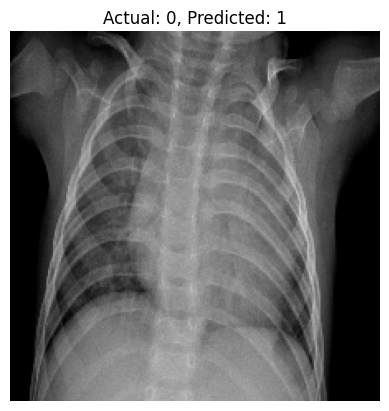

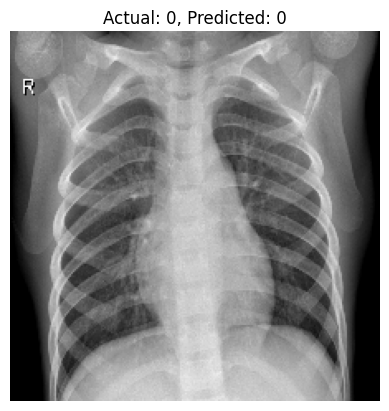

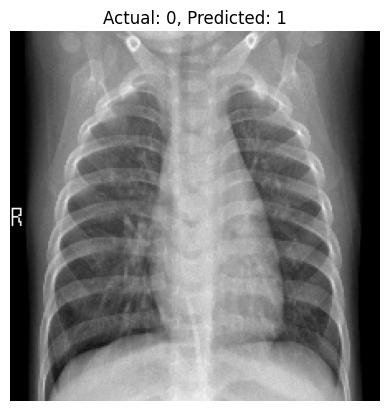

...

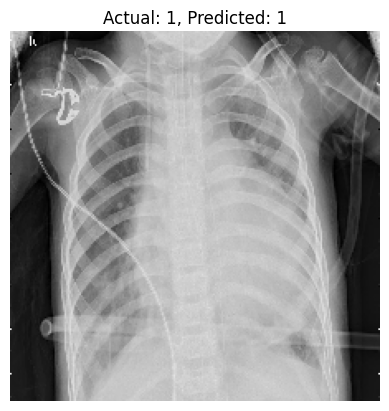

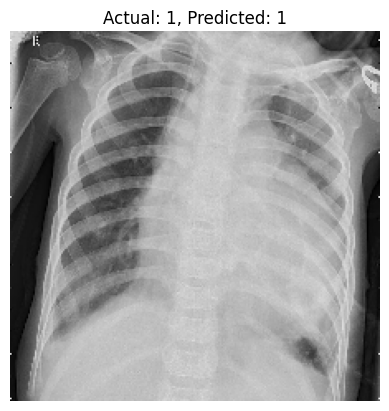

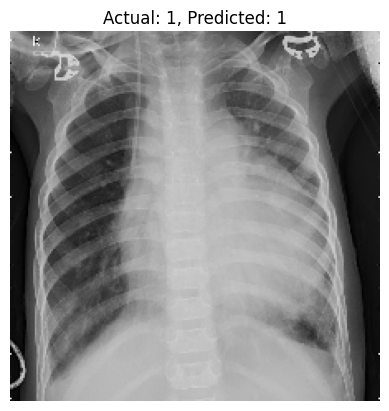

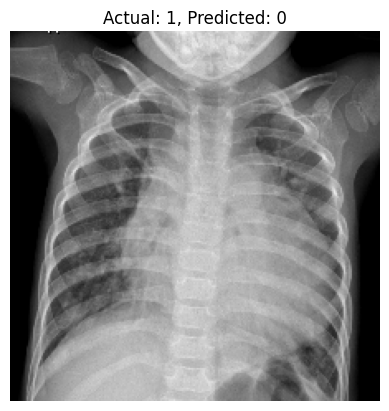

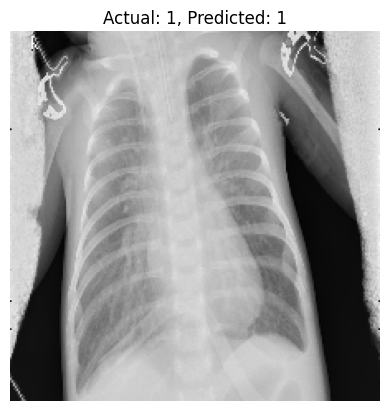

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


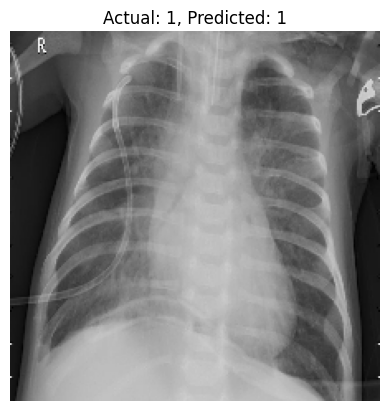

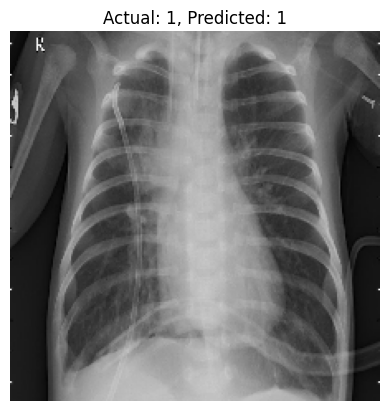

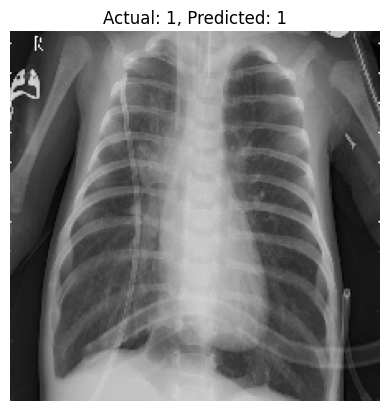

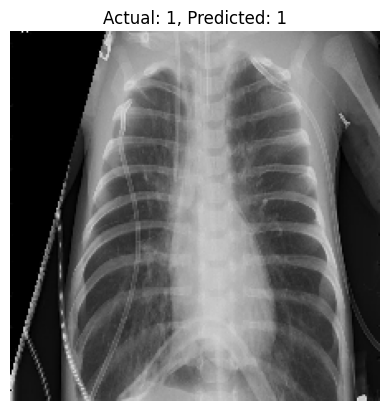

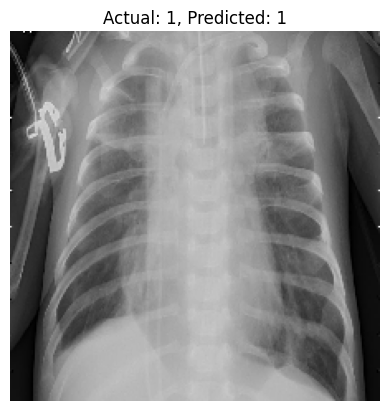

...

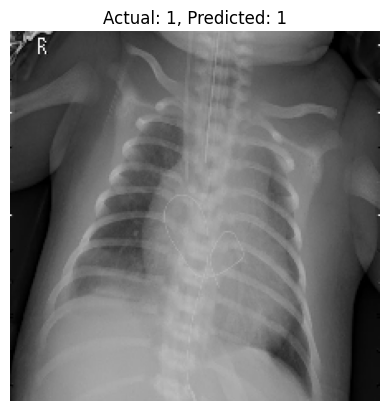

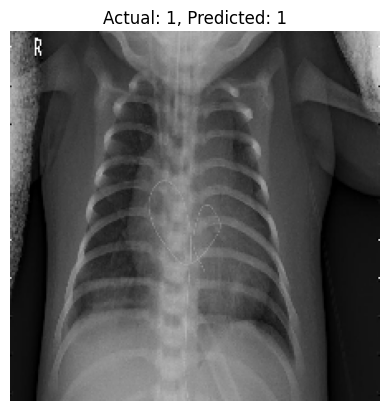

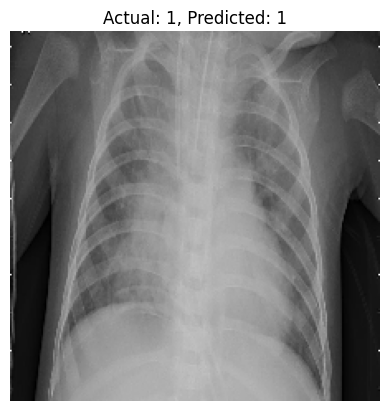

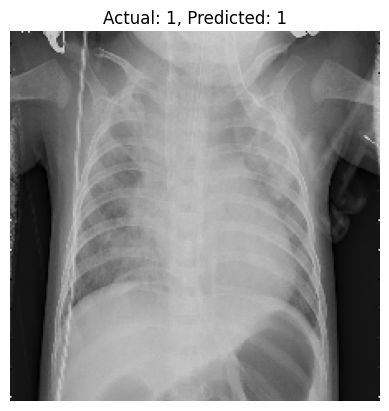

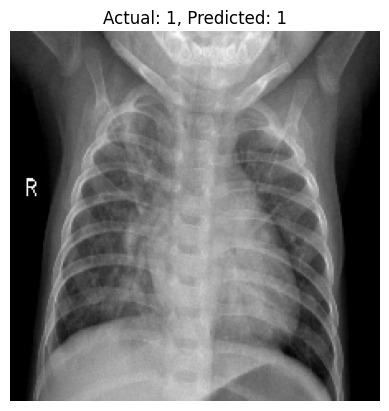

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


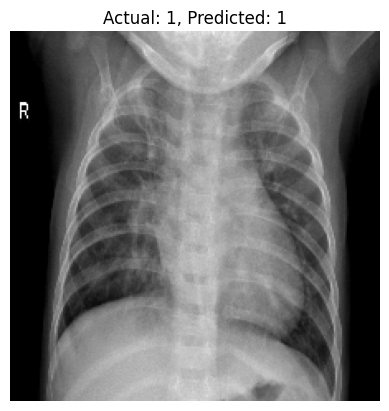

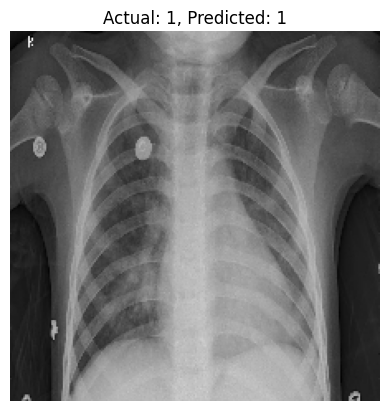

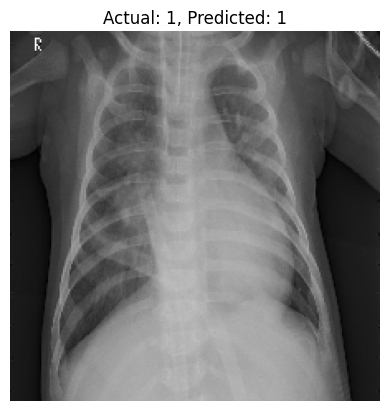

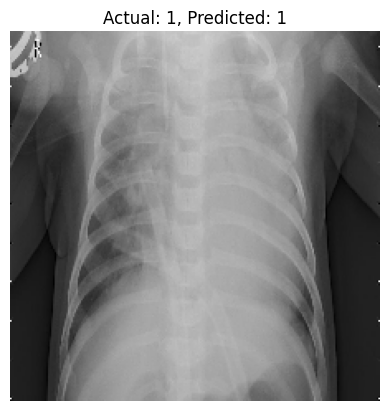

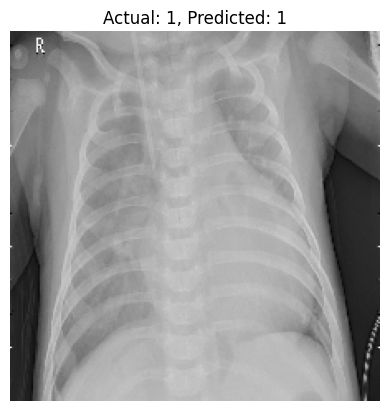

...

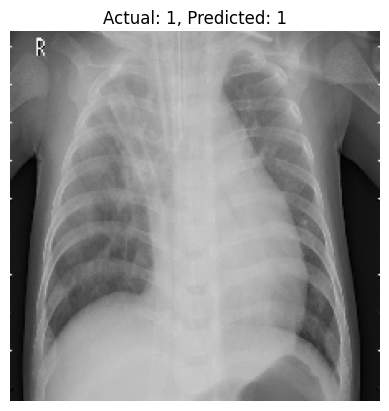

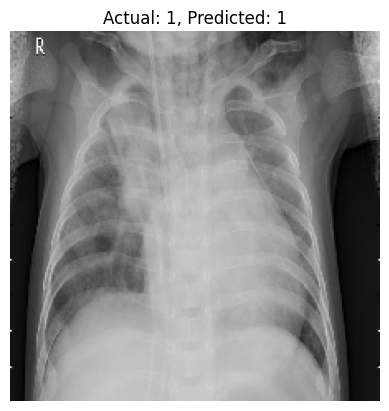

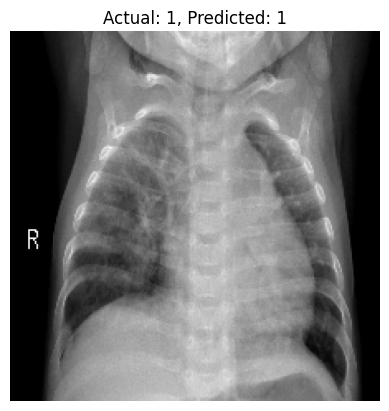

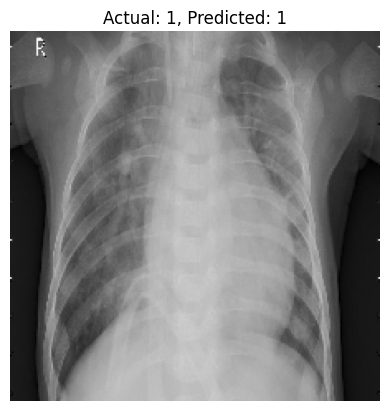

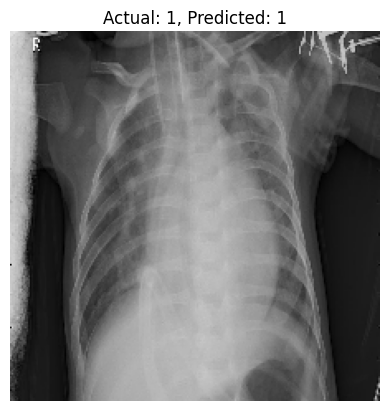

In [ ]:
# Get file paths
filenames = test_generator.filenames

# Show some correct and incorrect predictions
for i in range(10):
    img, label = test_generator[i]
    pred = model.predict(img)
    pred_label = (pred > 0.5).astype(int).flatten()
    actual_label = label.astype(int)

    for j in range(len(img)):
        plt.imshow(img[j])
        plt.title(f"Actual: {int(actual_label[j])}, Predicted: {int(pred_label[j])}")
        plt.axis('off')
        plt.show()


In [ ]:
'''
# Save in TensorFlow's SavedModel format
model.export('/content/drive/My Drive/pneumoniaDetectionModel_SavedModel')

# Save in HDF5 format
model.save('/content/drive/My Drive/pneumoniaDetectionModel.h5')

# Save new Keras format
model.save('/content/drive/My Drive/pneumoniaDetectionModel.keras')
'''

Saved artifact at '/content/drive/My Drive/pneumoniaDetectionModel_SavedModel'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='keras_tensor_69')
Output Type:
  TensorSpec(shape=(None, 1), dtype=tf.float32, name=None)
Captures:
  136554458446160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136554458444816: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088484752: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088483792: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088485136: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088483984: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088485520: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088485328: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088485904: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136553088485712: TensorSpec(shape=(), d